## Task and data

Given number of entries from fitness tracker that describes amount of steps taken by individual in determined amount of time. Goal is to create pipeline that can decide, is given day outliner or not.

## General idea

For the solution of this task I would like to consider approach based on time-series trend prediction and its confidence intervals to detect anomalies (outliners). As this task falls into unsupervised category because of non existent ground truth, I came up with euristic:   
1. Detect entries-outliners in time-series via FB prophet using widest possible confidence interval  
2. Calculate weight of ouliners like distance of entry to confidence interval's upper boundry  
3. Calculate sum of every day value entries and its count, then determine via sigma-rule most unlikely amount of steps and ist frequency in given day; same goes to anomalies in the same vein   
4. Create voting function that will decide type of the given day using parameters from previous steps

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import math
import numpy as np
from plotly.offline import init_notebook_mode, iplot
from plotly import graph_objs as go
import plotly.express as px
from scipy import stats
from fbprophet import Prophet
from fbprophet.plot import add_changepoints_to_plot
init_notebook_mode(connected=True)
plt.rcParams["figure.figsize"] = (12, 9)

Time offset is useless because we got dataset that contains only one user, so we can use local time

In [2]:
df = pd.read_csv('data.csv')

In [3]:
df.head()

,Time End,Time End Local Tz,Time Offset,Time Start,Time Start Local Tz,User ID,Value
0,2019-05-05T09:40:00+03:00,2019-05-05T12:40:00+03:00,10800,2019-05-05T09:39:59+03:00,2019-05-05T12:39:59+03:00,2166,1.0
1,2019-05-05T11:13:29+03:00,2019-05-05T14:13:29+03:00,10800,2019-05-05T11:12:51+03:00,2019-05-05T14:12:51+03:00,2166,34.0
2,2019-05-05T12:07:42+03:00,2019-05-05T15:07:42+03:00,10800,2019-05-05T12:07:39+03:00,2019-05-05T15:07:39+03:00,2166,1.0
3,2019-05-05T13:04:05+03:00,2019-05-05T16:04:05+03:00,10800,2019-05-05T13:04:02+03:00,2019-05-05T16:04:02+03:00,2166,3.0
4,2019-05-05T13:18:18+03:00,2019-05-05T16:18:18+03:00,10800,2019-05-05T13:18:13+03:00,2019-05-05T16:18:13+03:00,2166,6.0


In [4]:
df = df.sort_values('Time Start Local Tz').reset_index(drop='true')

In [5]:
df.nunique()

Time End               39671
Time End Local Tz      39671
Time Offset                2
Time Start             39671
Time Start Local Tz    39671
User ID                    1
Value                    670
dtype: int64

In [6]:
df['Time Offset'].unique()

array([10800,  7200], dtype=int64)

I pefer plotly over matplotlib for time-related data because of interactivity. Histogram dont give me any idea, other that Box-Cox transformation shows us that we cant normalize given data, and in that reagard using statistical tools became much trickier, so time-series toolkit is considered.

In [7]:
px.histogram(df, x="Value")

In [8]:
df['log_value'] = df['Value'].apply(math.log)
px.histogram(df, x='log_value')

Data cleaning; we can take center of time interval to reduce task complexity without loss of generality. We dont know the distribution of steps in each given interval, so we can assume uniform distribution.

In [9]:
clean_df = df.copy()

In [10]:
clean_df.drop(['Time Offset','Time End','Time Start','User ID','log_value'],axis=1,inplace=True)

In [11]:
clean_df['Time Start Local Tz'] = pd.to_datetime(clean_df['Time Start Local Tz'])
clean_df['Time End Local Tz'] = pd.to_datetime(clean_df['Time End Local Tz'])

In [12]:
clean_df['Lenght of sample'] = (clean_df['Time End Local Tz'] - clean_df['Time Start Local Tz']).dt.total_seconds()

In [13]:
clean_df['Median sample'] = clean_df['Time Start Local Tz']+pd.to_timedelta(clean_df['Lenght of sample']/2,unit='s')

In [14]:
clean_df.describe()

,Value,Lenght of sample
count,39671.000000,39671.000000
mean,39.936024,54.111820
std,129.078392,174.092053
min,1.000000,1.000000
25%,4.000000,3.000000
50%,8.000000,13.000000
75%,49.000000,59.000000
max,13508.000000,16083.000000


Text(0.5, 1.0, 'Box Cox coeff is -0.11318345075970287')

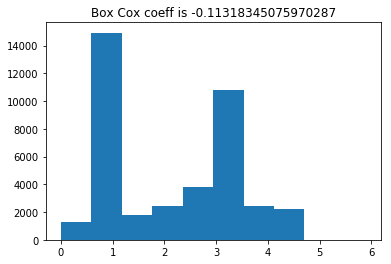

In [15]:
box_cox_len, _ = stats.boxcox(clean_df['Lenght of sample'])
plt.hist(box_cox_len)
plt.title('Box Cox coeff is {}'.format(_))

Picture is quite the same

In [16]:
import plotly.express as px
px.scatter(clean_df, x="Median sample", y="Lenght of sample",marginal_y="violin")

In [17]:
px.scatter(clean_df, x="Median sample", y="Value",marginal_y="violin")

Number of entries by hour looks quite logical, but median shows us that our subject have had few interesting nights

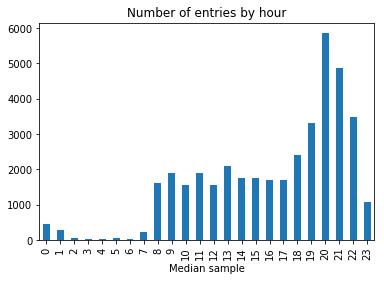

In [18]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.hour).count().plot(kind="bar",title='Number of entries by hour')

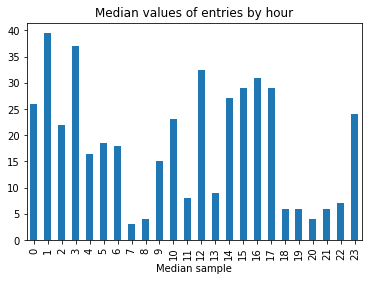

In [19]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.hour).median().plot(kind="bar",title='Median values of entries by hour')

Day of the week and day of the month number of entries distribuiton doesnt look suspicious

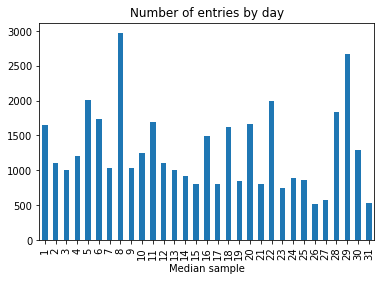

In [20]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.day).count().plot(kind="bar",title='Number of entries by day')

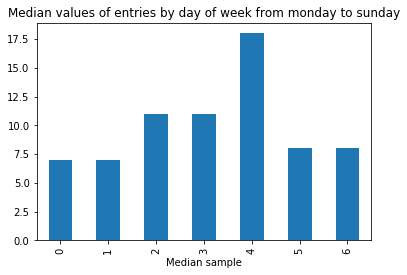

In [21]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.weekday).median().plot(kind="bar",title='Median values of entries by day of week from monday to sunday')

Prophet requires specific column names and removal of timezone ifnormation. We are using 99% confidence interval to make sure to detect most severe outliners. Daily season parameter is 15 as recommended by documentation to cacth sub-daily changes

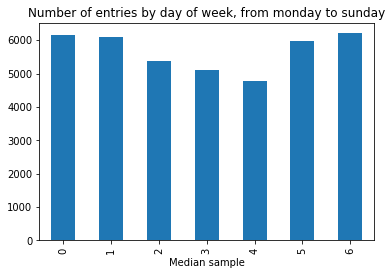

In [22]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.weekday).count().plot(kind="bar",title='Number of entries by day of week, from monday to sunday')

In [23]:
clean_df.drop(['Time End Local Tz','Time Start Local Tz','Lenght of sample'],axis=1,inplace=True)

In [24]:
clean_df.columns = ['y','ds']

In [25]:
clean_df['ds'] = clean_df['ds'].dt.tz_localize(None)

In [26]:
m = Prophet(daily_seasonality = 15, yearly_seasonality = False, weekly_seasonality = True,
                growth = 'linear',
                seasonality_mode = 'multiplicative', 
                interval_width = 0.99,
                changepoint_prior_scale=0.05)

In [27]:
m.fit(clean_df)

In [28]:
forecast = m.predict(clean_df)

Picture below represents prophet decision process, adding interactive visualisation at this point is pointless due to high computational cost of rendering it (tried write visualitsation on Altair by myself and use Plotly to see that it's kinda too much). In the end you can see somewhat optimized plotly graph.

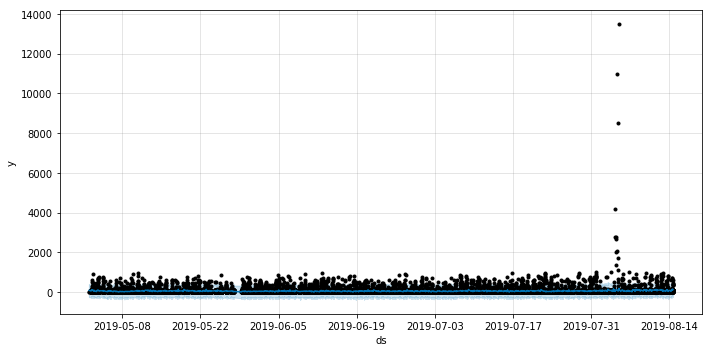

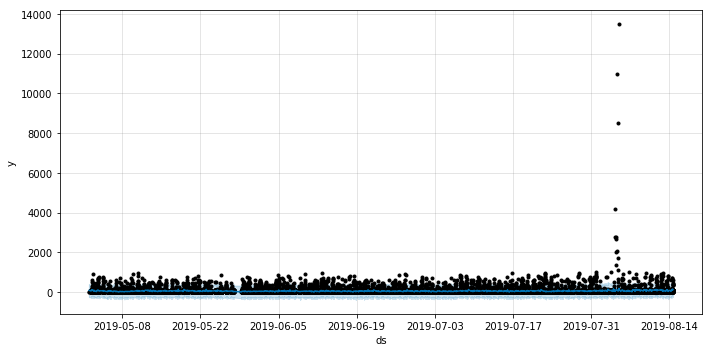

In [29]:
from fbprophet.plot import plot
plot(m, forecast, figsize=(10, 5))

Person in question definetly starts to walk more till the end of a summer

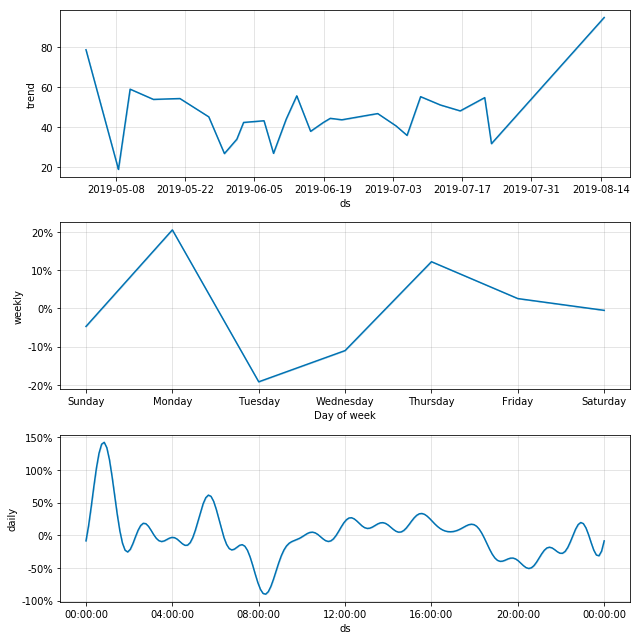

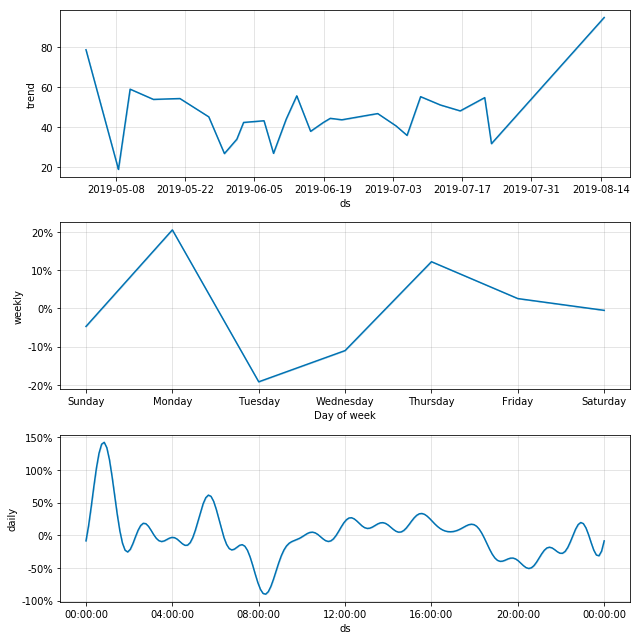

In [30]:
m.plot_components(forecast)

Every point thet higher upepr interval boundary (yhat_upper) to be considere outliner, and here we also introduce importance or weight to the anonaly - distance to yhat_upper

In [31]:
def detect_anomalies(forecast,original):
    forecasted = forecast[['ds','trend', 'yhat', 'yhat_lower', 'yhat_upper']].copy()
    forecasted['orig_value'] = original['y']
    forecasted['anomaly'] = 0
    forecasted.loc[original.y > forecasted['yhat_upper'], 'anomaly'] = 1
    forecasted.loc[original.y < forecasted['yhat_lower'], 'anomaly'] = -1

    forecasted['importance'] = 0
    forecasted.loc[forecasted['anomaly'] ==1, 'importance'] = \
        (original.y - forecasted['yhat_upper'])/forecasted['orig_value']
    forecasted.loc[forecasted['anomaly'] ==-1, 'importance'] = \
        (forecasted['yhat_lower'] - forecasted['orig_value'])/forecasted['orig_value']
    return forecasted

In [32]:
anomaly = detect_anomalies(forecast,clean_df)

Because outliner present in almot every day it is important to weight it

In [33]:
len(anomaly[anomaly['anomaly'] != 0]['ds'].dt.dayofyear.unique())

104

In [34]:
px.scatter(anomaly[anomaly['anomaly'] != 0], x="ds", y="importance",marginal_y="violin")

In [35]:
df_importance = anomaly[anomaly['anomaly'] != 0]['importance']

In [36]:
df_importance.describe([0.05,.25, .5, .75,0.95])

count    518.000000
mean       0.306163
std        0.183123
min        0.000400
5%         0.033744
25%        0.160986
50%        0.303295
75%        0.435532
95%        0.585661
max        0.962502
Name: importance, dtype: float64

Even if we choose important values with q1 in mind, their numbers do not lower considerably - they are almost uniformly distributed by days. Below you can see aggreagate functions and its visualisaion.

In [37]:
len(anomaly[(anomaly['anomaly'] != 0) & (anomaly['importance'] > 0.15)]['ds'].dt.dayofyear.unique())

102

In [38]:
df_important_anomalies = anomaly[(anomaly['anomaly'] != 0)& (anomaly['importance'] > 0.15)].groupby(
    anomaly[(anomaly['anomaly'] != 0) & (anomaly['importance'] > 0.15
    )]['ds'].dt.dayofyear)['anomaly'].count()

In [39]:
df_important_anomalies.describe([0.05,.25, .5, .75,0.95])

count    102.000000
mean       3.921569
std        2.597357
min        1.000000
5%         1.000000
25%        2.000000
50%        3.000000
75%        5.000000
95%        8.000000
max       14.000000
Name: anomaly, dtype: float64

In [40]:
fig = go.Figure()
fig.add_trace(go.Box(y=df_important_anomalies .values,name='Important anomalies'))
fig.add_trace(go.Box(y=df_importance.values,name='Importance'))

In [41]:
original_by_days_sum = anomaly['orig_value'].groupby(anomaly['ds'].dt.dayofyear).sum()

In [42]:
original_by_days_sum.describe([0.05,.25, .5, .75,0.95])

count      104.000000
mean     15233.673077
std       5895.482163
min       5776.000000
5%        8237.900000
25%      11692.750000
50%      14508.500000
75%      17268.750000
95%      22614.000000
max      53253.000000
Name: orig_value, dtype: float64

In [43]:
fig = go.Figure()
fig.add_trace(go.Box(y=original_by_days_sum.values,boxpoints='all',name='Sum of original values by days'))

In [44]:
original_by_days_count = anomaly['orig_value'].groupby(anomaly['ds'].dt.dayofyear).count()

In [45]:
fig = go.Figure()
fig.add_trace(go.Box(y=original_by_days_count.values,boxpoints='all',name='Count of original values by days'))

In [46]:
fig = go.Figure()
_ = anomaly[(anomaly['anomaly'] != 0) & (anomaly['importance'] > 0.15)].groupby(anomaly['ds'].dt.dayofyear)['anomaly'].count()
fig.add_trace(go.Box(y=_.values,boxpoints='all',name='"Important" anomalies by days'))

Above you can see outliners by different parameters, lets combine them and use voting function. Taking prophet prediction with added orignal values as input. Main goals is to detect important anomalies, for this I have chosen median of its distribution to cut off anomalies by number of its occurance in each day, if their number are higher than q3 - that's indicates unusual day. Next we observe number of entries in each day, if their number are low - that's definetly a day-outlier (like 28th of May), and we also need to consider sum of values per day as a patameter also.

In [47]:
def final_function(forecast):
    """
    Getting Prophet's prediction with added original values as an input and vote on nested functions results

    Parameters
    ----------
    forecast : pandas.DataFrame
        Prophet's forecast with added original values

    Returns
    -------
    DataFrame with outlier days marked up
    """
    def get_important_anomalies_count(f_cast):
        """
        Grouping importance by days, calculating median value and by it we getting rid of unimportant
        outliers, then we count it in each day and calculating q1 and q3.

        Parameters
        ----------
        f_cast : pandas.DataFrame
            Prophet's forecast with added original values

        Returns
        -------
        Marked anomalies and 1-st and 3-rd quartile.
        """
        q2_c = f_cast[f_cast['anomaly'] != 0]['importance'].quantile(0.5)
        res = f_cast[(f_cast['anomaly'] != 0) & (f_cast['importance'] > q2_c)].groupby(
            f_cast[(f_cast['anomaly'] != 0) & (f_cast['importance'] > q2_c
                                               )]['ds'].dt.dayofyear)['anomaly'].count()
        q1, q3 = res.quantile([0.25, 0.75])
        return res, q1, q3

    def get_value_sum(f_cast):
        """
        Functions that calculate sum of steps per day and quartiles.

        Parameters
        ----------
        f_cast : pandas.DataFrame
            Prophet's forecast with added original values

        Returns
        -------
        List that contain sum of steps in each day, q1 and q3.
        """
        res = f_cast['orig_value'].groupby(f_cast['ds'].dt.dayofyear).sum()
        q1, q3 = res.quantile([0.25, 0.75])
        return res, q1, q3

    def get_value_count(f_cast):
        """
        Functions that calculate number of entries per day and quartiles.

        Parameters
        ----------
        f_cast : pandas.DataFrame
            Prophet's forecast with added original values

        Returns
        -------
        List that contain number of entries in each day, q1 and q3.
        """
        res = f_cast['orig_value'].groupby(f_cast['ds'].dt.dayofyear).count()
        q1, q3 = res.quantile([0.25, 0.75])
        return res, q1, q3

    def anomaly_count(val, q1, q3):
        """
        Functions that decides is  number of anomalies in this day are acceptable.


        Parameters
        ----------
        val : int
            Number of steps per day
        q1 : float
            First quartiles of number of steps per day distribution
        q3 : float
            Third quartiles of number of steps per day distribution

        Returns
        -------
        None
        """
        if q1 <= val <= q3:
            return -1
        elif val > (q1 + q3) / 2:
            return 1
        else:
            return 0

    def lower_limit_values_sum(val, q1, q3):
        """
        Functions that decides is  sum of steps in this day are normal in respect to  lower limit.


        Parameters
        ----------
        val : int
            Number of steps per day
        q1 : float
            First quartile of number of steps per day distribution
        q3 : float
            Third quartile of number of steps per day distribution

        Returns
        -------
        None
        """
        upper_fence = q3 + 1.5 * (q3 - q1)
        if q1 <= val <= q3:
            return 0
        elif val < q1 or val > q3:
            return 1
        elif q3 <= val <= upper_fence:
            return -1

    def lower_limit_values_count(val, q1, q3):
        """
        Functions that decides is number of entries in this day are normal in respect to  lower limit.


        Parameters
        ----------
        val : int
            Number of steps per day
        q1 : float
            First quartile of number of steps per day distribution
        q3 : float
            Third quartile of number of steps per day distribution

        Returns
        -------
        None
        """
        upper_fence = q3 + 1.5 * (q3 - q1)
        if val < q1 or val > upper_fence:
            return 1
        elif q3 < val <= upper_fence:
            return -1
        else:
            return 0

    def voting_function(series1, series2, series3):
        """
        Function that votes, choosing most common type of markdown, or if all different then uses
        sum of steps per day as a guideline.

        Parameters
        ----------
        series1 : list[int]
            Markdown for sum of steps parameter
        series2 : list[int]
            Markdown for number of entries parameter
        series3 : list[int]
            Markdown for low limit of sum of values parameter

        Returns
        -------
        List of final mark up for original values
        """
        res = []
        for val_1, val_2, val_3 in zip(series1, series2, series3):
            _ = [val_1, val_2, val_3]
            # Behaviour with 3 different values in val_1, val_2, val_3 is intended:
            # we consider that first parameter outweighs all other in this case
            res.append(max(_, key=_.count))
        return res

    anomaly_grouped = forecast.groupby(forecast['ds'].dt.dayofyear).count()
    anomaly_grouped['anomaly_important'], q1_anom, q3_anom = get_important_anomalies_count(forecast)
    value_sum, q1_sum, q3_sum = get_value_sum(forecast)
    value_count, q1_count, q3_count = get_value_count(forecast)

    anomaly_grouped['uncertanty_by_anomalies'] = \
        anomaly_grouped['anomaly_important'].apply(anomaly_count, args=(q1_anom, q3_anom))
    anomaly_grouped['uncertanty_by_value_sum'] = value_sum.apply(lower_limit_values_sum, args=(q1_sum, q3_sum))
    anomaly_grouped['uncertanty_by_value_count'] = \
        value_count.apply(lower_limit_values_count, args=(q1_count, q3_count))
    anomaly_grouped['uncertanty_voted'] = voting_function(anomaly_grouped['uncertanty_by_anomalies'],
                                                          anomaly_grouped['uncertanty_by_value_sum'],
                                                          anomaly_grouped['uncertanty_by_value_count'])
    return anomaly_grouped

In [48]:
almost = final_function(anomaly)

Visualisation

In [49]:
final = clean_df.copy()
final['anomaly'] = final['ds'].dt.dayofyear.map(almost['uncertanty_voted'].to_dict())

In [50]:
final['anomaly'].value_counts()

-1    15741
 1    12607
 0    11323
Name: anomaly, dtype: int64

Graph is interactive and somewhat acceptable on rendering cost, but if we add more elements - it causes troubles. Here:  
1 is day-outlier  
0 is usual day  
-1 is undeterminded (cant determine is it outlier or not) 

In [51]:
fig = px.scatter(final, x="ds", y="y",color="anomaly",color_continuous_scale=px.colors.sequential.Inferno_r)
fig.add_trace(go.Scatter(x = final.ds, y = anomaly.yhat_upper,connectgaps=True,
                         name="Prophet upper boundary", line=dict(color='royalblue', width=4)))
fig.update_layout(legend_orientation="h")

Due to github constaints on rendering plotly graphs directly from Ipython Notebook, I added html version of it here

In [57]:
from IPython.display import IFrame

IFrame(src='./figure.html', width=1000, height=600)

## Conclusion

Final result can be seen in a cvs file, which was marked down by days. Also I would like to mention that clusterisation approach to oulier detection didnt get me somewhat acceptavble resulst, adding more features (like time lag) also doesnt help. Adding regressors to a Prophet causes model to overtrain (used it with time lag feature also). Unsupervised learning task like this can definetly provide some challenge. Thanks for your attention. 

In [52]:
result = final.resample('D', on='ds').mean().replace(np.NaN, 1).drop('y',axis=1)

In [53]:
#result.to_csv('result.csv')

In [54]:
# import plotly.io as pio

# pio.write_html(fig, file='figure.html', auto_open=True)